# **Image Generation and Background Replacement using Stable Diffusion**

## **Introduction**
This notebook demonstrates advanced image generation and editing capabilities using state-of-the-art models like Stable Diffusion 3.5, Kandinsky, and FLUX-1. It focuses on generating high-quality images, segmenting objects, and performing tasks like object replacement and background editing.

---

## **Project Goals**
- Explore **Stable Diffusion 3.5**, **Kandinsky**, and other cutting-edge models for image generation and editing tasks.
- Implement **automatic segmentation** to isolate and edit specific objects within an image.
- Enable functionality for **object replacement** using a custom pipeline that combines segmentation and inpainting.
- Discuss **technical aspects** of **CLIP-based selection** for targeted object editing.

---
## **Content Overview**

### **1. Model Comparison and Visual Results**
- **Stable Diffusion 3.5**: Enhanced image generation with adapters and masking capabilities.
- **Kandinsky**: Experimenting with detailed and creative text-to-image outputs.

### **2. Adapter Fusion**
- **Stable Diffusion 3.5 Adapters**: Utilizing adapters for fine-tuning and boosting model performance on specific tasks.

### **3. Quantization**
- Quantization process of the model


### **4. Image Generation and Object Replacement**
- **Image Segmentation**: Generating mask of the object
- **Inpaint Model**: Disscuss different Inpaint models.
- **Final Model** : Implementing Final object replacement Model

---

## **Resources Used in this notebook**:
Model Comparison Docs(Asked in the Assignment): https://docs.google.com/document/d/1bJXsXkju1l7PGfqxeooeds0NwjPYYrEF-Pq25ZDvvc8/edit?usp=sharing

Images used:
1. https://drive.google.com/file/d/1CWYSyGRJsNV9zPMnrXUlZpczc5LRurF9/view?usp=sharing

2. https://drive.google.com/file/d/1KRwloQl_KYqmhOYmVGIG9MB5R009tClA/view?usp=sharing


# Installation and Setup

In [1]:
# Installation of all the required packages
!pip install diffusers transformers accelerate scipy
!pip install torch torchvision diffusers opencv-python pillow segment-anything transformers

In [2]:
 # login through huggingface token
 !huggingface-cli login


    _|    _|  _|    _|    _|_|_|    _|_|_|  _|_|_|  _|      _|    _|_|_|      _|_|_|_|    _|_|      _|_|_|  _|_|_|_|
    _|    _|  _|    _|  _|        _|          _|    _|_|    _|  _|            _|        _|    _|  _|        _|
    _|_|_|_|  _|    _|  _|  _|_|  _|  _|_|    _|    _|  _|  _|  _|  _|_|      _|_|_|    _|_|_|_|  _|        _|_|_|
    _|    _|  _|    _|  _|    _|  _|    _|    _|    _|    _|_|  _|    _|      _|        _|    _|  _|        _|
    _|    _|    _|_|      _|_|_|    _|_|_|  _|_|_|  _|      _|    _|_|_|      _|        _|    _|    _|_|_|  _|_|_|_|

    A token is already saved on your machine. Run `huggingface-cli whoami` to get more information or `huggingface-cli logout` if you want to log out.
    Setting a new token will erase the existing one.
    To log in, `huggingface_hub` requires a token generated from https://huggingface.co/settings/tokens .
Enter your token (input will not be visible): 
Add token as git credential? (Y/n) Y
Token is valid (permission: fineG

# 1. Model Comparison and Visual Results

I have conducted a detailed comparison between the four models: **Stable Diffusion 3**, **Stable Diffusion 3.5**, **Kandinsky**, and **FLUX-1**. For the full technical comparison, including architectural differences and strengths, please refer to the [comparison document](https://docs.google.com/document/d/1bJXsXkju1l7PGfqxeooeds0NwjPYYrEF-Pq25ZDvvc8/edit?usp=sharing).

Below, you will find the **visual results** generated using these models, showcasing their capabilities in tasks like text-to-image, inpainting, and image-to-image generation.


## Stable Diffusion 3.5

In [ ]:
from diffusers import AutoPipelineForText2Image
import torch

Loading pipeline components...:   0%|          | 0/9 [00:00<?, ?it/s]

You set `add_prefix_space`. The tokenizer needs to be converted from the slow tokenizers


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

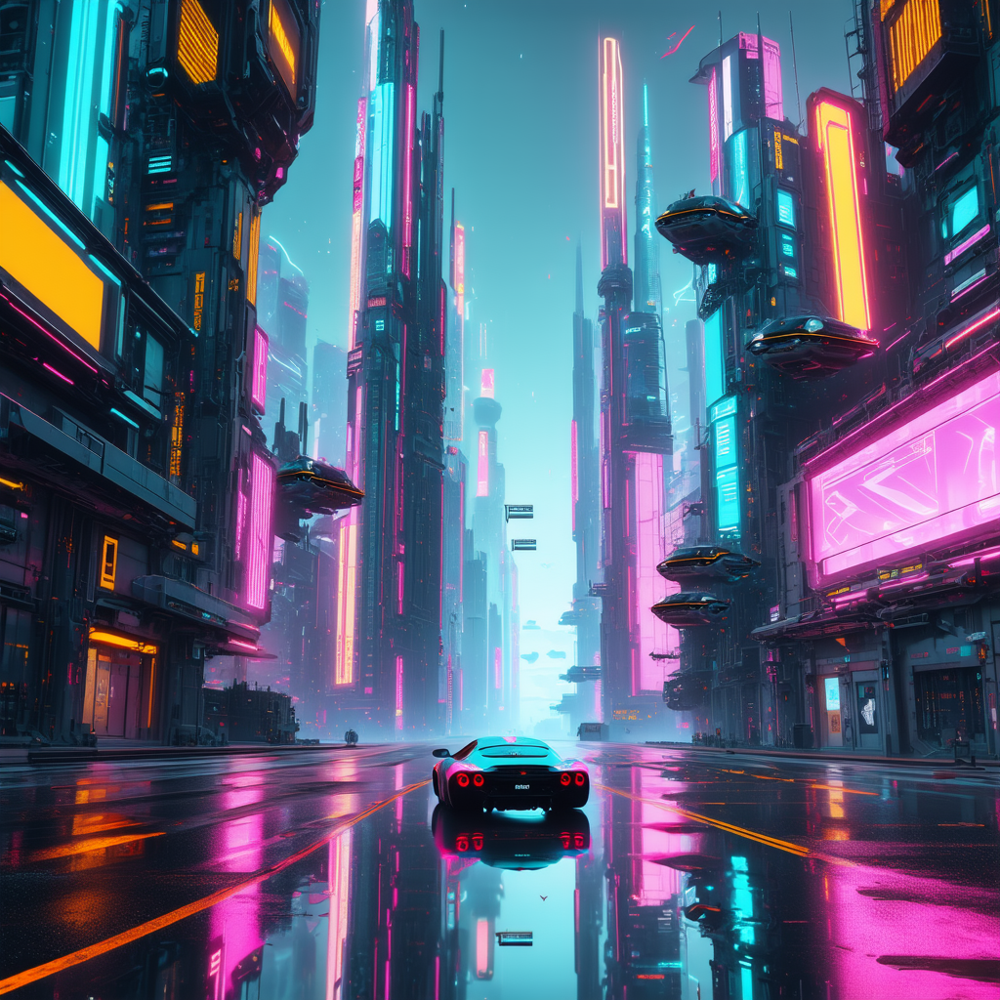

In [ ]:
# Import the AutoPipelineForText2Image class from the diffusers library
from diffusers import AutoPipelineForText2Image
import torch
pipelinesd3_5 = AutoPipelineForText2Image.from_pretrained(
    "stabilityai/stable-diffusion-3.5-medium",  # Model identifier on Hugging Face
    torch_dtype=torch.float16
).to("cuda")

# Define a random seed for reproducibility in generating images
generator = torch.Generator("cuda").manual_seed(31)  # Ensure the same output for the same prompt and settings

# Configure pipeline parameters
prompt = "Futuristic cityscape at night, glowing neon lights, towering skyscrapers, flying cars, cyberpunk aesthetic, detailed reflections on wet streets, vibrant colors, ultra-realistic, cinematic composition"  # Main input text prompt
negative_prompt = "blurry, low resolution, poorly detailed, distorted, overexposed, dark shadows, over-saturated colors, unrealistic proportions, noisy background, grainy textur"                   # Attributes to avoid in the output image
guidance_scale = 7.5      # Higher values make the image align more closely to the text prompt but may reduce creativity
num_inference_steps = 50  # Number of steps in the diffusion process (more steps = better quality but slower generation)

imagesd3_5 = pipelinesd3_5(
    prompt,
    negative_prompt=negative_prompt,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    generator=generator
).images[0]

imagesd3_5

## Kandinsky 2.2

In [ ]:
# Import the AutoPipelineForText2Image class from the diffusers library
from diffusers import AutoPipelineForText2Image
import torch

# Load the pre-trained Kandinsky 2.2 model's text-to-image pipeline
pipeline = AutoPipelineForText2Image.from_pretrained(
    "kandinsky-community/kandinsky-2-2-decoder",  # Model identifier on Hugging Face
    torch_dtype=torch.float16
).to("cuda")

# Define a random seed for reproducibility in generating images
generator = torch.Generator("cuda").manual_seed(31)  # Ensure the same output for the same prompt and settings

# Configure pipeline parameters
prompt = "Futuristic cityscape at night, glowing neon lights, towering skyscrapers, flying cars, cyberpunk aesthetic, detailed reflections on wet streets, vibrant colors, ultra-realistic, cinematic composition"  # Main input text prompt
negative_prompt = "blurry, low resolution, poorly detailed, distorted, overexposed, dark shadows, over-saturated colors, unrealistic proportions, noisy background, grainy textur"                   # Attributes to avoid in the output image
guidance_scale = 7.5      # Higher values make the image align more closely to the text prompt but may reduce creativity
num_inference_steps = 50  # Number of steps in the diffusion process (more steps = better quality but slower generation)

imagekd2 = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    generator=generator
).images[0]




Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/diffusers/pipelines/kandinsky2_2/pipeline_kandinsky2_2.py:202: FutureWarning: `callback_steps` is deprecated and will be removed in version 1.0.0. Passing `callback_steps` as an input argument to `__call__` is deprecated, consider use `callback_on_step_end`
  deprecate(


  0%|          | 0/50 [00:00<?, ?it/s]

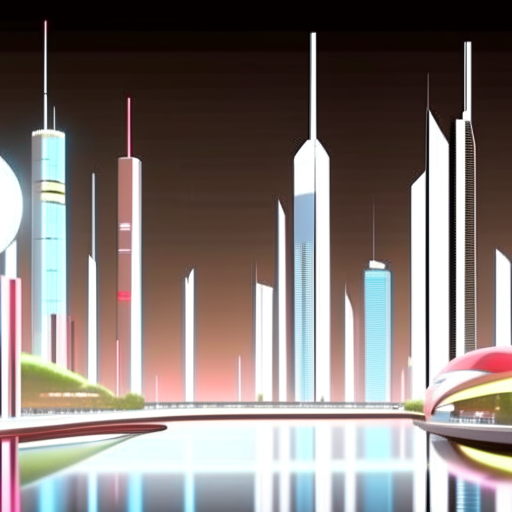

In [ ]:
imagekd2

# 2. Adapter Fusion

Adapters are lightweight, task-specific modules integrated into large-scale models to enhance their adaptability and efficiency. Unlike traditional fine-tuning, which requires updating the entire model, adapters introduce additional layers to adjust the model's performance for specific tasks without retraining the core model.

I will use stabilityai/stable-diffusion-3.5-medium

This model has 32 pretrained adapter in huggingface

In [ ]:

# Load the pre-trained stable-diffusion-3.5-medium model's text-to-image pipeline
pipelinesd3_5_1 = AutoPipelineForText2Image.from_pretrained(
    "stabilityai/stable-diffusion-3.5-medium",  # Model identifier on Hugging Face
    torch_dtype=torch.float16
).to("cuda")


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/706 [00:00<?, ?B/s]

Fetching 26 files:   0%|          | 0/26 [00:00<?, ?it/s]

text_encoder_3/config.json:   0%|          | 0.00/740 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/141 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/247M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/4.53G [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/4.99G [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/574 [00:00<?, ?B/s]

(…)t_encoder_3/model.safetensors.index.json:   0%|          | 0.00/19.9k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/588 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/705 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/576 [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/856 [00:00<?, ?B/s]

tokenizer_3/special_tokens_map.json:   0%|          | 0.00/2.54k [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/4.94G [00:00<?, ?B/s]

tokenizer_3/tokenizer.json:   0%|          | 0.00/2.42M [00:00<?, ?B/s]

transformer/config.json:   0%|          | 0.00/524 [00:00<?, ?B/s]

tokenizer_3/tokenizer_config.json:   0%|          | 0.00/20.6k [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/809 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/168M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/9 [00:00<?, ?it/s]

You set `add_prefix_space`. The tokenizer needs to be converted from the slow tokenizers


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Lets use the first adapter - Clybius/mspaint-style-sd3.5medium adapter that has been fine-tuned to generate pixel art images

In [ ]:
pipelinesd3_5_1.load_lora_weights("Clybius/mspaint-style-sd3.5medium", weight_name="mspaint-style-sd3-FinallyGoodEdition.safetensors",adapter_name="mspaint")
generator = torch.Generator("cuda").manual_seed(31)
# below is the prompt and mspaint style is the trigger word
prompt = "mspaint style a cute and friendly dog with soft fur, bright eyes, and a joyful expression. "  # Main input text prompt
image2 =pipelinesd3_5_1(
    prompt,
    generator=generator
).images[0]


  0%|          | 0/28 [00:00<?, ?it/s]

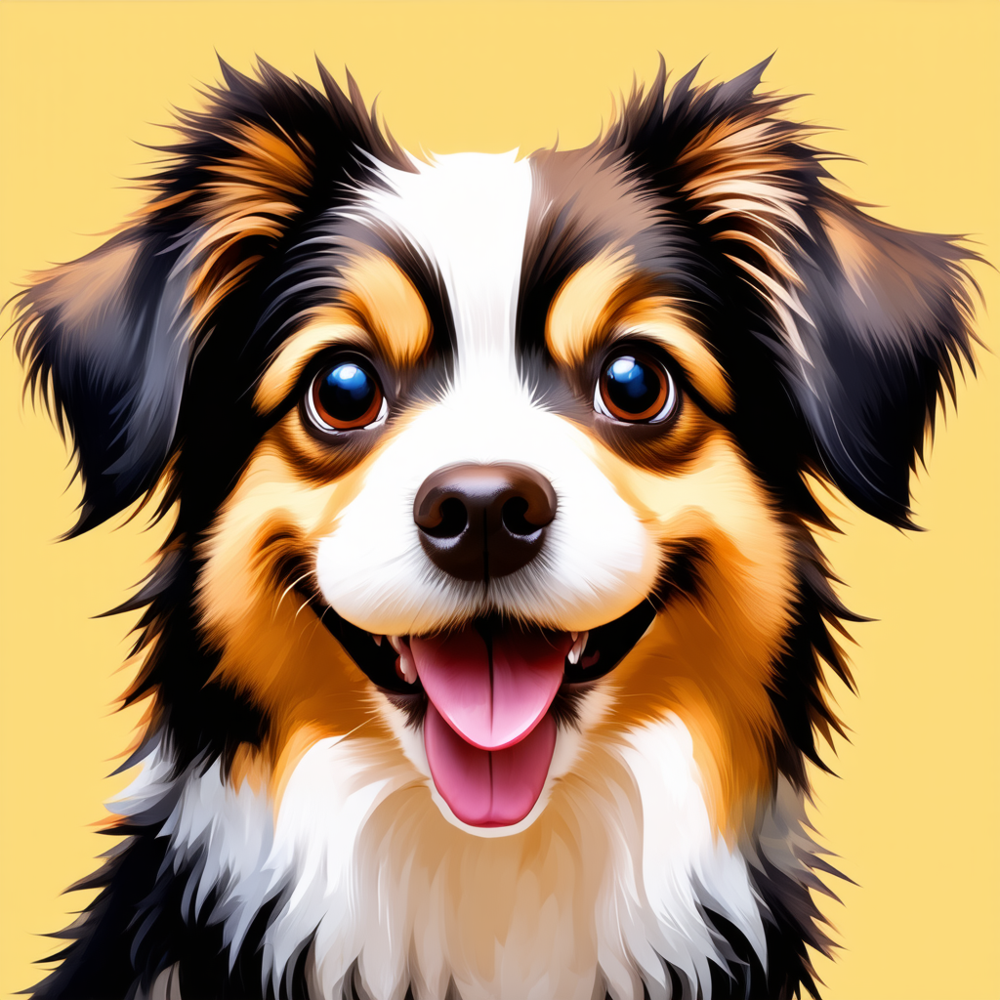

In [ ]:
image2

Second adapter - JINTAIRE/anime_pose
This adapter has been fine-tuned to generate pixel art images


In [ ]:
pipelinesd3_5_1.load_lora_weights("JINTAIRE/anime_pose",weight_name="anime pose(final).safetensors",adapter_name="anime")

  0%|          | 0/28 [00:00<?, ?it/s]

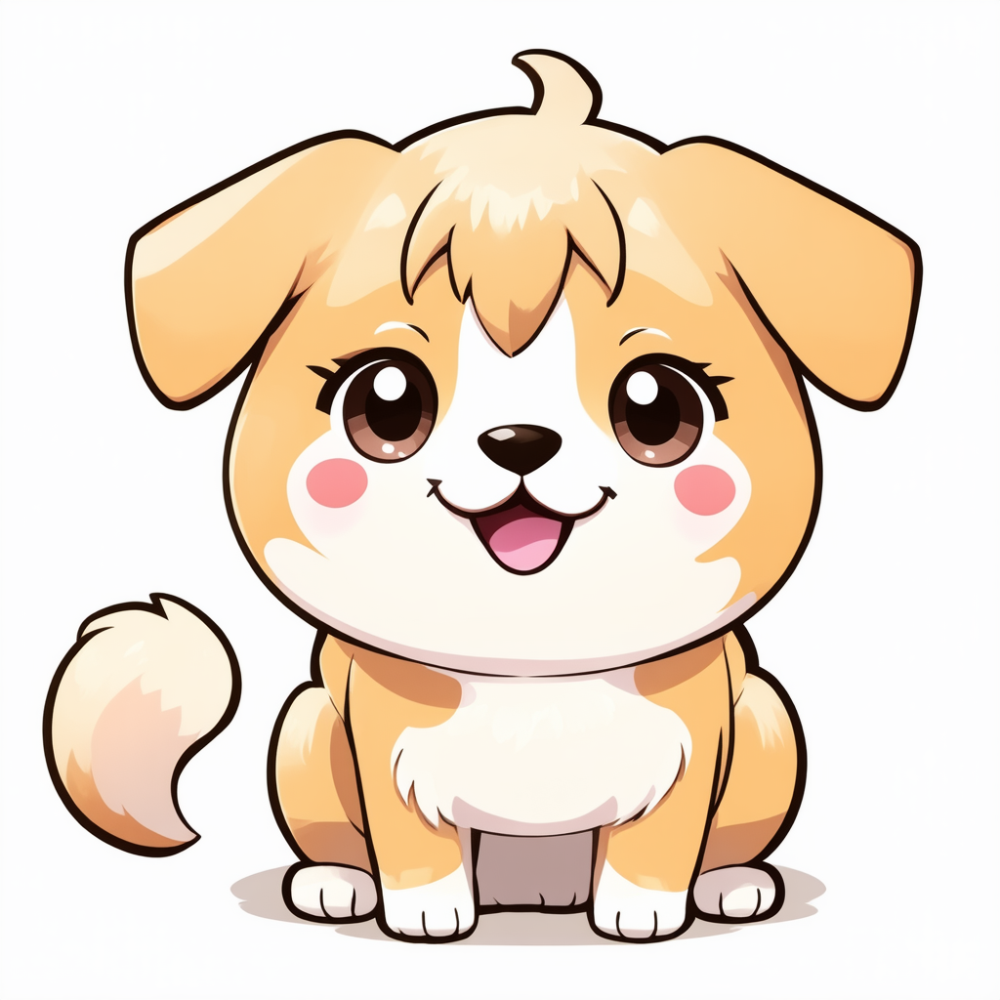

In [ ]:
# below is the prompt and anime pose is the trigger word
generator = torch.Generator("cuda").manual_seed(31)
prompt = "anime pose,a cute and friendly dog with soft fur, bright eyes, and a joyful expression. "  # Main input text prompt
image =pipelinesd3_5_1(
    prompt,
    generator=generator
).images[0]
image

Image generation without adapters

  0%|          | 0/28 [00:00<?, ?it/s]

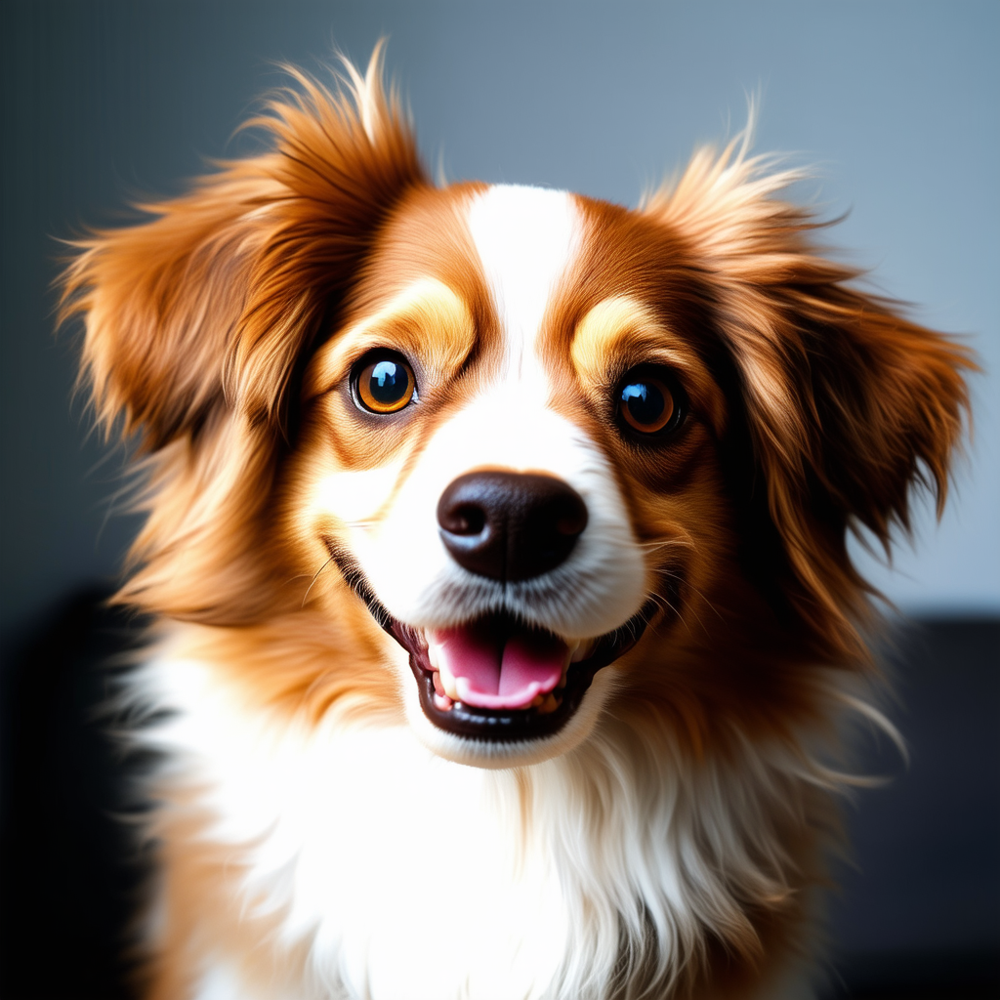

In [ ]:
pipelinesd3_5_1.disable_lora() # To remove the adapters and regain the model original weights

prompt = "a cute and friendly dog with soft fur, bright eyes, and a joyful expression."
image_original = pipelinesd3_5_1(prompt, generator=generator).images[0]
image_original

# 3. Quantization

Adapters are lightweight, task-specific modules integrated into large-scale models to enhance their adaptability and efficiency. Unlike traditional fine-tuning, which requires updating the entire model, adapters introduce additional layers to adjust the model's performance for specific tasks without retraining the core model.

They can be used to provide special and custamize styling to the generated image

I will use stabilityai/stable-diffusion-3.5-medium

This model has 32 pretrained adapter in huggingface

In [ ]:
pip install bitsandbytes -U

In [ ]:
from diffusers import BitsAndBytesConfig, SD3Transformer2DModel
from diffusers import StableDiffusion3Pipeline
import torch

In [ ]:

model_id = "stabilityai/stable-diffusion-3.5-medium"

# Configure the 4-bit quantization to reduce memory usage and improve inference speed
nf4_config = BitsAndBytesConfig(
    load_in_4bit=True,  # Enables 4-bit precision for weights, reducing model size
    bnb_4bit_quant_type="nf4",  # Specifies the NF4 quantization type for better accuracy compared to FP4
)

# Load the Stable Diffusion 3.5 Medium model's transformer component
model_nf4 = SD3Transformer2DModel.from_pretrained(
    model_id,                # The pre-trained model's identifier from Hugging Face
    subfolder="transformer", # Points to the specific subfolder containing the transformer model
    quantization_config=nf4_config, # Applies the 4-bit quantization configuration defined above
    torch_dtype=torch.bfloat16     # Specifies the data type for computations (bfloat16 is efficient for mixed-precision)
)

# At this point, the model is loaded with reduced memory requirements due to NF4 quantization
# and is ready for tasks like text-to-image generation or fine-tuning.


In [ ]:
# saving the quantized model
model_nf4.save_pretrained("/content/drive/MyDrive/Quantized_sd3.5_model")

# 4. Object Replacement Feature


## Image segmentation

For this task I am using SAM (Segment Anything Model)

In [4]:
# install required library
!pip install torch torchvision diffusers opencv-python pillow segment-anything transformers

In [5]:
# Downloading SAM (segment anything model) weights
!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

--2024-12-15 16:08:18--  https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 108.157.254.121, 108.157.254.15, 108.157.254.102, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|108.157.254.121|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2564550879 (2.4G) [binary/octet-stream]
Saving to: ‘sam_vit_h_4b8939.pth’

sam_vit_h_4b8939.pt 100%[===================>]   2.39G   284MB/s    in 8.9s    

2024-12-15 16:08:27 (275 MB/s) - ‘sam_vit_h_4b8939.pth’ saved [2564550879/2564550879]



In [6]:
#Importing Libraries
from segment_anything import SamPredictor, sam_model_registry
from diffusers import StableDiffusionInpaintPipeline
from PIL import Image
import numpy as np
import torch
from transformers import CLIPProcessor, CLIPModel

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [7]:
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator


# **Step 1: Load the SAM model**
sam_checkpoint = "/content/sam_vit_h_4b8939.pth"
model_type = "vit_h"
sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
mask_generator = SamAutomaticMaskGenerator(sam)






/usr/local/lib/python3.10/dist-packages/segment_anything/build_sam.py:105: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(f)


In [8]:
# Fuction to Segment the Image
def segmentar(image_path):
# Step 2: Load the image
  image = cv2.imread(image_path)
  image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Step 3: Generate all masks for the image
  masks = mask_generator.generate(image_rgb)

# Step 4: Create a segmentation mask
  segmented_image = np.zeros_like(image_rgb)

# Assign random colors for each mask
  for mask in masks:
      color = np.random.randint(0, 255, size=3)  # Random color
      segmented_image[mask["segmentation"]] = color

# Step 5: Visualize the segmented image
  plt.figure(figsize=(10, 5))
  plt.subplot(1, 2, 1)
  plt.imshow(image_rgb)
  plt.title("Original Image")
  plt.axis("off")

  plt.subplot(1, 2, 2)
  plt.imshow(segmented_image)
  plt.title("Segmented Image")
  plt.axis("off")

  plt.tight_layout()
  plt.show()
  return segmented_image,masks

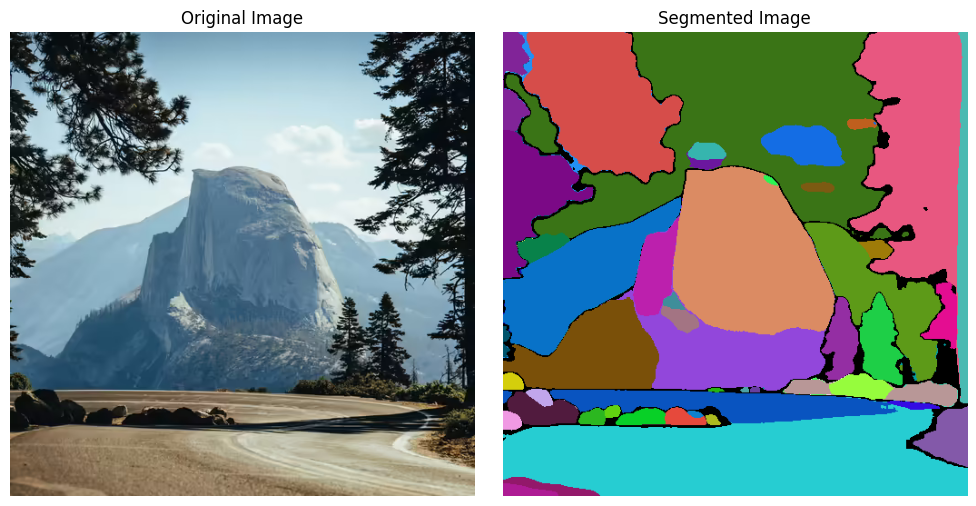

In [14]:
segmented_image,masks=segmentar('/content/inpaint.png')


SAM (Segment Anything Model) efficiently segments an image into multiple regions, assigning each object its own mask. However, selecting a specific class for replacement, like choosing only the "dog" from an image with a "car" and "dog," poses a challenge.

To address this, I opted for CLIP (Contrastive Language–Image Pretraining), which aligns text and image embeddings for semantic understanding.

**Here's how it works:**

**Generate Masks:** SAM segments the image into distinct regions, providing masks for all objects.
**Input Text Prompt:** The user specifies the desired object, e.g., "dog."
**CLIP Matching:**
Each mask is converted into an individual image.The text prompt and each mask are processed using CLIP to compute similarity scores.
**Select the Best Match:** The mask with the highest score relative to the prompt is identified as the desired object.

Below I have used an image in which I want to replace the hill with a castle

In this techinque we need to specify the object we want to remove and in this case it is hill

In [9]:
import numpy as np
import torch
from PIL import Image
import matplotlib.pyplot as plt
from transformers import CLIPProcessor, CLIPModel

# Load CLIP model and processor
clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/4.19k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/605M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

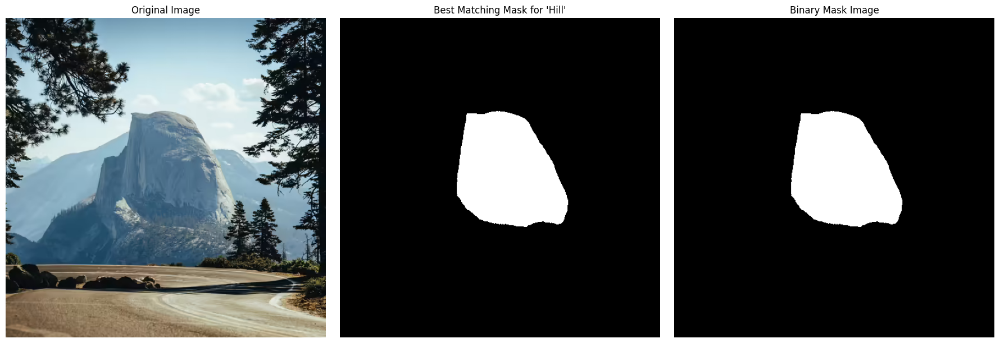

In [15]:


def select_best_mask(masks, object_to_replace, original_image):
    """
    Select the best mask matching the object name using CLIP.

    Args:
        masks: List of mask dictionaries with "segmentation" key (numpy arrays).
        object_to_replace: Text description of the object to select (e.g., "tree").
        original_image: The original image for visualization.

    Returns:
        binary_mask: PIL image of the selected binary mask.
        selected_mask: Selected mask as a numpy array.
    """
    mask_scores = []

    # Compare each mask to the text input using CLIP
    for mask in masks:
        mask_image = Image.fromarray((mask["segmentation"] * 255).astype(np.uint8))
        inputs = clip_processor(text=[object_to_replace], images=mask_image, return_tensors="pt", padding=True)
        outputs = clip_model(**inputs)
        logits_per_image = outputs.logits_per_image
        mask_scores.append(logits_per_image.item())

    # Select the best matching mask
    best_mask_idx = np.argmax(mask_scores)
    selected_mask = masks[best_mask_idx]["segmentation"]

    # Convert the selected mask to a binary mask image
    binary_mask = (selected_mask * 255).astype(np.uint8)
    return Image.fromarray(binary_mask), selected_mask


original_image = Image.open("/content/inpaint.png")  # Path to the original image

# Input: Object name to find
object_name = "Hill"

# Run the mask selection process
binary_mask, selected_mask = select_best_mask(masks, object_name, original_image)

# Display results
fig, ax = plt.subplots(1, 3, figsize=(18, 6))

ax[0].imshow(original_image)
ax[0].set_title("Original Image")
ax[0].axis("off")

ax[1].imshow(selected_mask, cmap="gray")
ax[1].set_title(f"Best Matching Mask for '{object_name}'")
ax[1].axis("off")

ax[2].imshow(binary_mask, cmap="gray")
ax[2].set_title("Binary Mask Image")
ax[2].axis("off")

plt.tight_layout()
plt.show()


As we can see here this approch perfectly segment the hill area out of other classes

## Inpaint model
In this section I have compared different inpaint models like     **stable-diffusion-3.5**, **diffusers/stable-diffusion-xl-1.0-inpainting-0.1** ,**kandinsky-community/kandinsky-2-2-decoder-inpaint**


There is no dedicated inpaint model of stable-diffusion-3.5 so I will use the original model to see what it will generate


In [ ]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "stabilityai/stable-diffusion-3.5-medium", torch_dtype=torch.float16
)
pipeline.enable_model_cpu_offload()

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/706 [00:00<?, ?B/s]

Fetching 26 files:   0%|          | 0/26 [00:00<?, ?it/s]

text_encoder/config.json:   0%|          | 0.00/574 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/247M [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/141 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/4.53G [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/4.99G [00:00<?, ?B/s]

text_encoder_3/config.json:   0%|          | 0.00/740 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/588 [00:00<?, ?B/s]

(…)t_encoder_3/model.safetensors.index.json:   0%|          | 0.00/19.9k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/705 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/576 [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/856 [00:00<?, ?B/s]

tokenizer_3/special_tokens_map.json:   0%|          | 0.00/2.54k [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

tokenizer_3/tokenizer.json:   0%|          | 0.00/2.42M [00:00<?, ?B/s]

tokenizer_3/tokenizer_config.json:   0%|          | 0.00/20.6k [00:00<?, ?B/s]

transformer/config.json:   0%|          | 0.00/524 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/809 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/4.94G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/168M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/9 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

You set `add_prefix_space`. The tokenizer needs to be converted from the slow tokenizers


  0%|          | 0/30 [00:00<?, ?it/s]

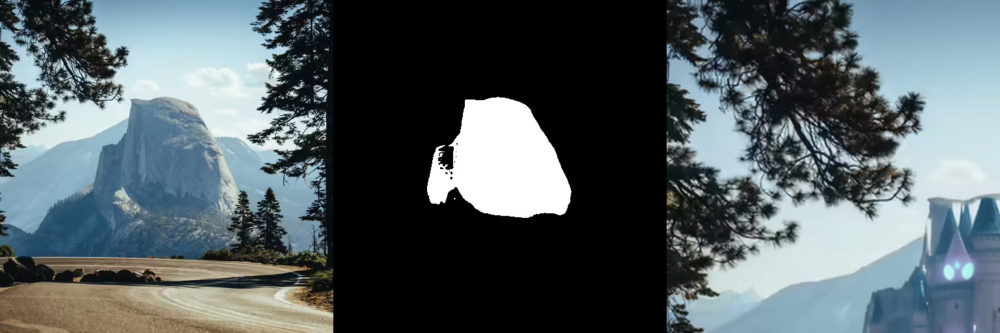

In [ ]:
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")
prompt = "a big castle with glowing eyes, cute, adorable, disney, pixar, highly detailed, 8k"
negative_prompt = " deformed, ugly, disfigured"
image = pipeline(prompt=prompt, negative_prompt=negative_prompt, image=init_image, mask_image=mask_image).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

Second model-diffusers/stable-diffusion-xl-1.0-inpainting-0.1

In [3]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline_dfinpaint = AutoPipelineForInpainting.from_pretrained(
    "diffusers/stable-diffusion-xl-1.0-inpainting-0.1", torch_dtype=torch.float16
)
pipeline_dfinpaint.enable_model_cpu_offload()

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

The config attributes {'decay': 0.9999, 'inv_gamma': 1.0, 'min_decay': 0.0, 'optimization_step': 37000, 'power': 0.6666666666666666, 'update_after_step': 0, 'use_ema_warmup': False} were passed to UNet2DConditionModel, but are not expected and will be ignored. Please verify your config.json configuration file.


  0%|          | 0/49 [00:00<?, ?it/s]

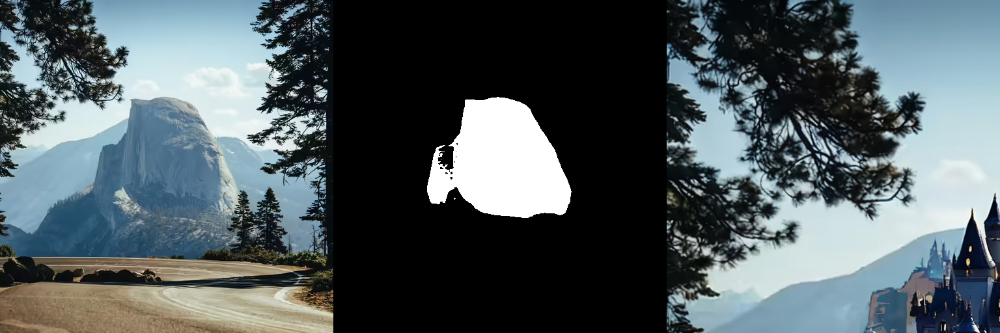

In [4]:
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")
prompt = "a big castle with glowing eyes, cute, adorable, disney, pixar, highly detailed, 8k"
negative_prompt = "bad anatomy, deformed, ugly, disfigured"
image = pipeline_dfinpaint(prompt=prompt, negative_prompt=negative_prompt, image=init_image, mask_image=mask_image).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

Third Model - kandinsky-2-2-decoder-inpaint

In [ ]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline2 = AutoPipelineForInpainting.from_pretrained(
    "kandinsky-community/kandinsky-2-2-decoder-inpaint", torch_dtype=torch.float16
)
pipeline2.enable_model_cpu_offload()

Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

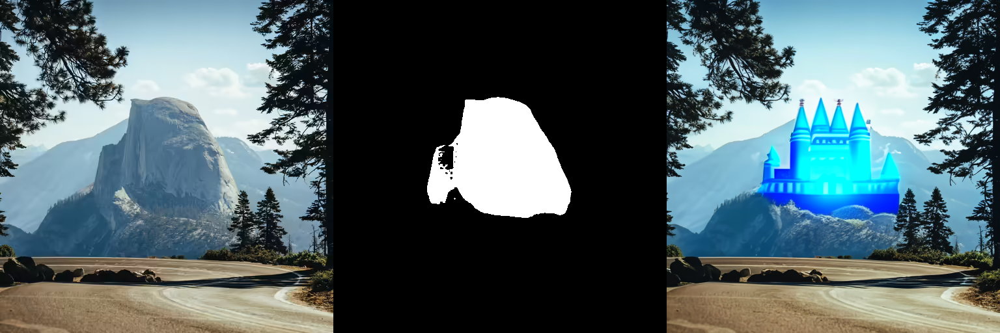

In [ ]:
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")
prompt = "a big castle with glowing eyes, cute, adorable, disney, pixar, highly detailed, 8k"
negative_prompt = "bad anatomy, deformed, ugly, disfigured"
image = pipeline2(prompt=prompt, negative_prompt=negative_prompt, image=init_image, mask_image=mask_image).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

Let's try to erase using kandinsky-2-2-decoder-inpaint

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

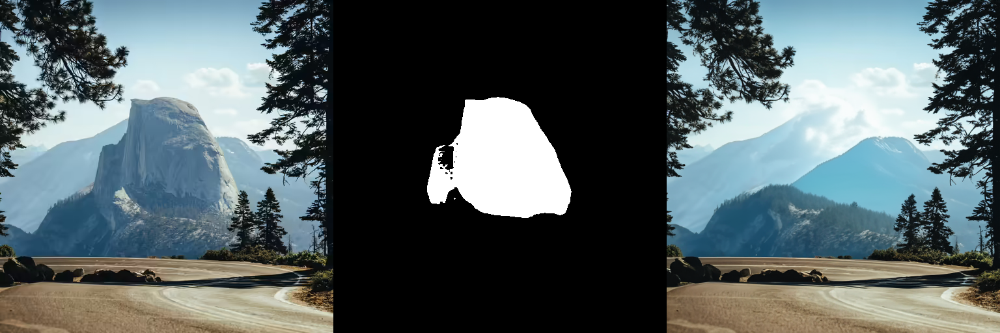

In [ ]:
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")
prompt = "A clean and conasistent background that blends naturally with the surroundings, with no traces of the removed object."
negative_prompt = "Artifacts, blurriness, extra objects, unnatural distortions, irregular patterns."
image = pipeline2(prompt=prompt, negative_prompt=negative_prompt, image=init_image, mask_image=mask_image).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

So after reviewing all the three model we found that kandinsky-2-2-decoder-inpaint is performing better

## Final Model
we have done the segmentation and inpaint model selection. Let's build the full model

In [11]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline2 = AutoPipelineForInpainting.from_pretrained(
    "kandinsky-community/kandinsky-2-2-decoder-inpaint", torch_dtype=torch.float16
)
pipeline2.enable_model_cpu_offload()

model_index.json:   0%|          | 0.00/257 [00:00<?, ?B/s]

Fetching 7 files:   0%|          | 0/7 [00:00<?, ?it/s]

movq/config.json:   0%|          | 0.00/660 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/5.72k [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/318 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.67k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/5.01G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/271M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

model_index.json:   0%|          | 0.00/501 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/3.69G [00:00<?, ?B/s]

image_encoder/config.json:   0%|          | 0.00/2.01k [00:00<?, ?B/s]

image_processor/preprocessor_config.json:   0%|          | 0.00/315 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/229 [00:00<?, ?B/s]

prior/config.json:   0%|          | 0.00/252 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/2.02k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/4.10G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/904 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

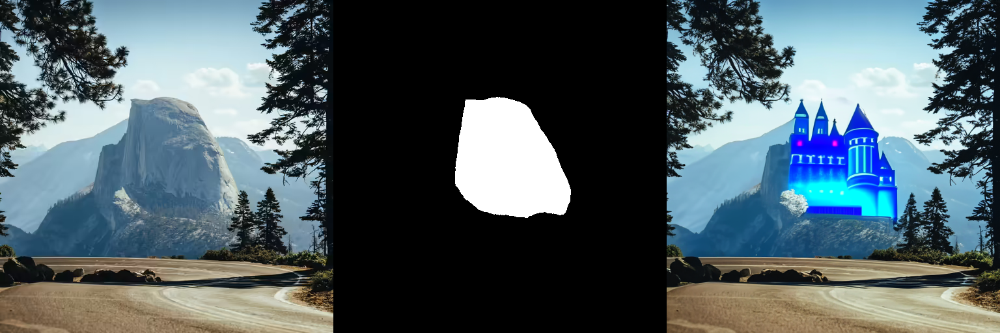

In [16]:
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
prompt = "a big castle with glowing eyes, cute, adorable, disney, pixar, highly detailed, 8k"
negative_prompt = "bad anatomy, deformed, ugly, disfigured"
image = pipeline2(prompt=prompt, negative_prompt=negative_prompt, image=init_image, mask_image=binary_mask).images[0]
make_image_grid([init_image, binary_mask, image], rows=1, cols=3)

Let's try on some different image

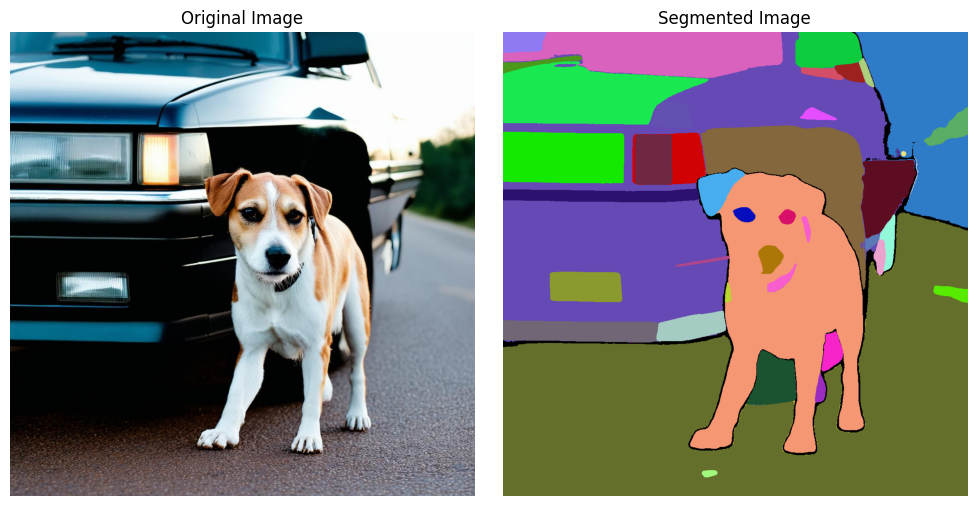

In [17]:
init_image = load_image("/content/f392ac59-3765-43e1-bfec-d04957f78862.jpeg")
segmented_image,masks=segmentar('/content/f392ac59-3765-43e1-bfec-d04957f78862.jpeg')

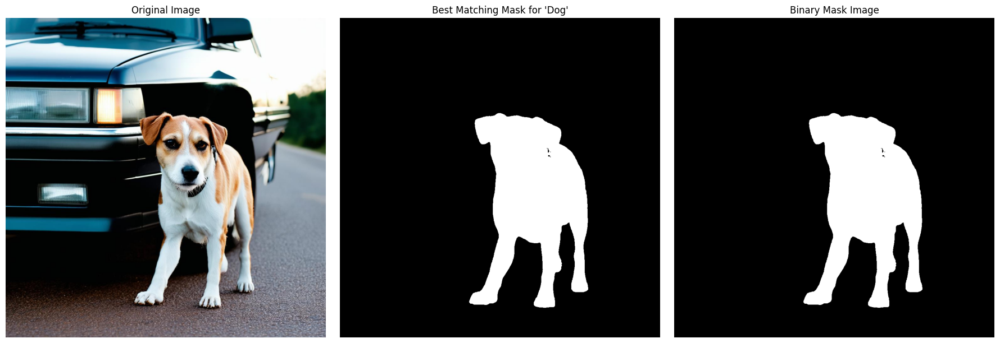

In [18]:
original_image = Image.open("/content/f392ac59-3765-43e1-bfec-d04957f78862.jpeg")  # Path to the original image
# Dummy masks

# Input: Object name to find
object_name = "Dog"

# Run the mask selection process
binary_mask, selected_mask = select_best_mask(masks, object_name, original_image)

# Display results
fig, ax = plt.subplots(1, 3, figsize=(18, 6))

ax[0].imshow(original_image)
ax[0].set_title("Original Image")
ax[0].axis("off")

ax[1].imshow(selected_mask, cmap="gray")
ax[1].set_title(f"Best Matching Mask for '{object_name}'")
ax[1].axis("off")

ax[2].imshow(binary_mask, cmap="gray")
ax[2].set_title("Binary Mask Image")
ax[2].axis("off")

plt.tight_layout()
plt.show()

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

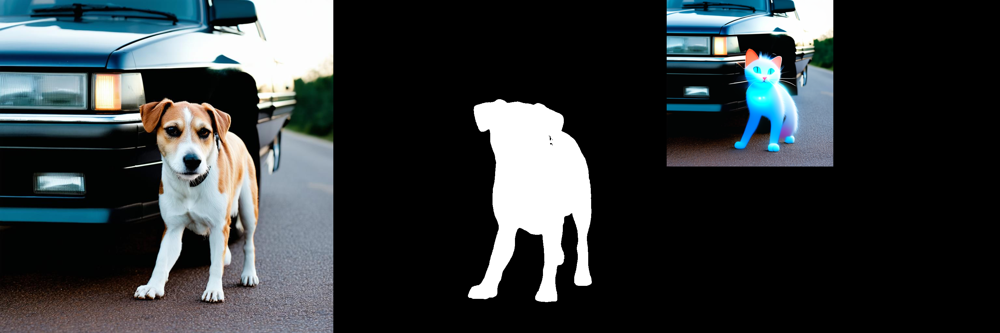

In [ ]:
prompt = "a white cat with glowing eyes, cute, adorable, disney, pixar, highly detailed, 8k"
negative_prompt = "bad anatomy, deformed, ugly, disfigured"
image = pipeline2(prompt=prompt, negative_prompt=negative_prompt, image=init_image, mask_image=binary_mask).images[0]
make_image_grid([init_image, binary_mask, image], rows=1, cols=3)

While Stable Diffusion 3.5 demonstrates limitations in inpainting accuracy, we can enhance its performance by employing a custom pipeline with manual masking.

**The Proposed Approach:**

This method leverages the image-to-image pipeline in Stable Diffusion 3 or 3.5, combined with a binary mask that specifies the region to be modified. The steps are as follows:

**Generate a Binary Mask:** Create a mask highlighting the specific area of the image you want to edit.

**Image-to-Image Pipeline:** Apply the mask within the pipeline to restrict edits solely to the masked region, leaving the rest of the image untouched.

Although this is not a dedicated inpainting model, it effectively mimics inpainting functionality by isolating changes to targeted areas. This approach provides more control over edits and can significantly enhance the quality of inpainting tasks.

In [21]:
from diffusers import AutoPipelineForImage2Image
from PIL import Image, ImageChops, ImageDraw
import torch

# Load Stable Diffusion 3 or 3.5 pipeline
model_name = "stabilityai/stable-diffusion-3.5-medium"  # Replace this with SD 3 or SD 3.5 checkpoint
pipe = AutoPipelineForImage2Image.from_pretrained(model_name, torch_dtype=torch.float16)
pipe = pipe.to("cuda")


# Create a "composite" image where only the masked region is modified
def apply_mask(original_image, mask, inpainted_image):
    """ Combine inpainted regions with original image using a mask. """
    return Image.composite(inpainted_image, original_image, mask)

# Generate image-to-image result based on the masked area
prompt = "Add a cat in the masked area"
strength = 0.8  # Controls how much the input image is modified

# Fill masked area with text-to-image
inpainting_result = pipe(prompt=prompt, image=init_image, strength=strength).images[0]

# Apply mask to merge inpainted region back into the original image
final_image = apply_mask(init_image, binary_mask, inpainting_result)

# Save the output
final_image.save("sd3_inpainting_output.png")
print("Inpainting completed and saved as sd3_inpainting_output.png")


Loading pipeline components...:   0%|          | 0/9 [00:00<?, ?it/s]

You set `add_prefix_space`. The tokenizer needs to be converted from the slow tokenizers


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

Inpainting completed and saved as sd3_inpainting_output.png


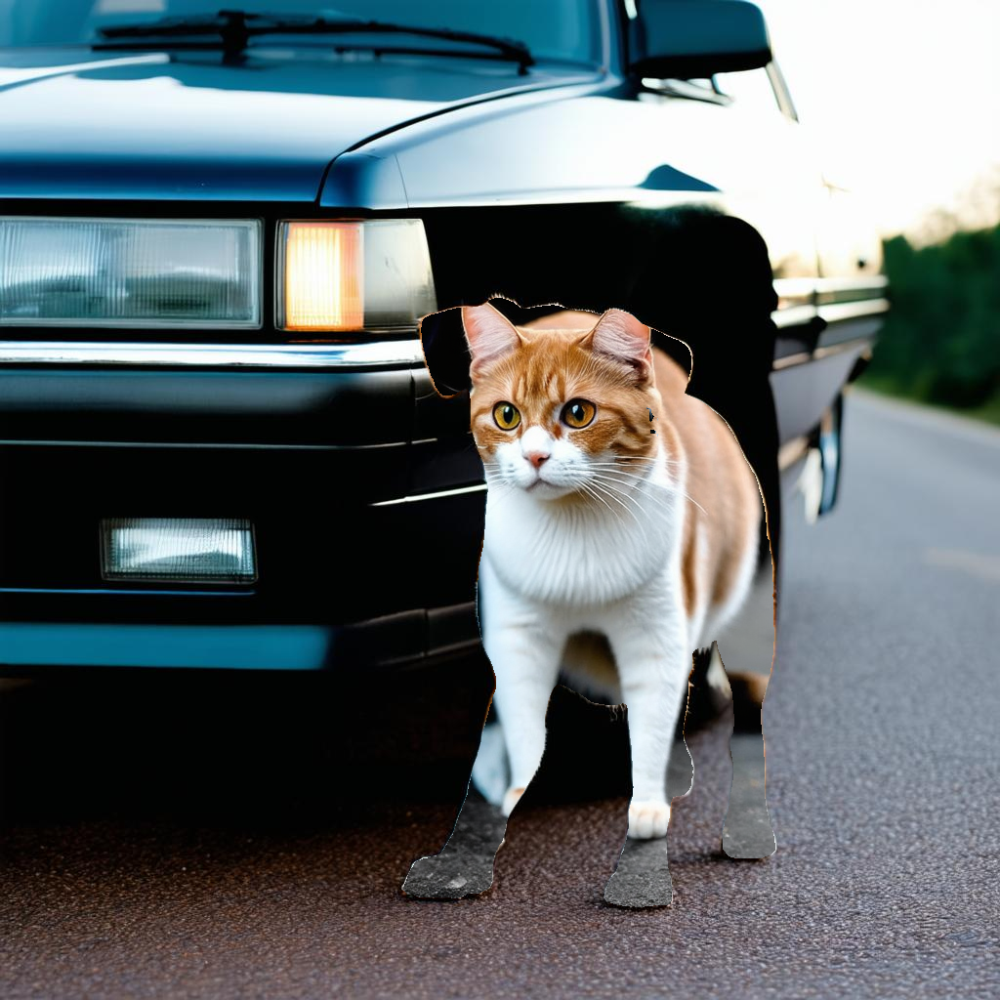

In [22]:
final_image

This method has Improved the performance